<a href="https://colab.research.google.com/github/gaydaazaid/Unsupervised-/blob/main/UNSUPERVISED.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

###**Getting the data and EDA**

In [ ]:
#Visualization and data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import missingno as msno 
import pandas_profiling as pp
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import os
from google.colab import drive
from scipy import stats

#SKLEARN
from sklearn.preprocessing import StandardScaler,normalize,MinMaxScaler, RobustScaler
from sklearn.cluster import KMeans,Birch
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.impute import KNNImputer
from yellowbrick.cluster import (
    kelbow_visualizer,
    silhouette_visualizer,
    intercluster_distance,
)



In [ ]:
drive.mount('/content/gdrive')
data=pd.read_csv('/content/gdrive/MyDrive/marketing_data.csv')
data.drop(['CUST_ID'],axis=1,inplace=True)
data
#we dropped the CUST_ID column since it's not useful

Mounted at /content/gdrive


,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [ ]:
data.shape

(8950, 17)


**About Dataset
This case requires to develop a customer segmentation to define marketing strategy. The sample Dataset summarizes the usage behavior of about 9000 active credit card holders during the last 6 months. The file is at a customer level with 18 behavioral variables.** 

* CUST_ID : Identification of Credit Card holder (Categorical)

* BALANCE : Balance amount left in their account to make purchases

* BALANCE_FREQUENCY : How frequently the Balance is updated, score between 
  0 and 1 (1 = frequently updated, 0 = not frequently updated)

* PURCHASES : Amount of purchases made from account

* ONEOFF_PURCHASES : Maximum purchase amount done in one-go

* INSTALLMENTS_PURCHASES : Amount of purchase done in installment


* CASH_ADVANCE : Cash in advance given by the user


* PURCHASES_FREQUENCY : How frequently the Purchases are being made, 
  score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)


* ONEOFFPURCHASESFREQUENCY : How frequently Purchases are happening in 
  one-go (1 = frequently purchased, 0 = not frequently purchased)

* PURCHASESINSTALLMENTSFREQUENCY : How frequently purchases in installments 
  are being done (1 = frequently done, 0 = not frequently done)

* CASHADVANCEFREQUENCY : How frequently the cash in advance being paid

* CASHADVANCETRX : Number of Transactions made with "Cash in Advanced"

* PURCHASES_TRX: Numbe of purchase transactions made

* CREDIT_LIMIT : Limit of Credit Card for user

* PAYMENTS : Amount of Payment done by user

* MINIMUM_PAYMENTS : Minimum amount of payments made by user

* PRCFULLPAYMENT : Percent of full payment paid by user

* TENURE : Tenure of credit card service for user


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 17 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   BALANCE                           8950 non-null   float64
 1   BALANCE_FREQUENCY                 8950 non-null   float64
 2   PURCHASES                         8950 non-null   float64
 3   ONEOFF_PURCHASES                  8950 non-null   float64
 4   INSTALLMENTS_PURCHASES            8950 non-null   float64
 5   CASH_ADVANCE                      8950 non-null   float64
 6   PURCHASES_FREQUENCY               8950 non-null   float64
 7   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 8   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 9   CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 10  CASH_ADVANCE_TRX                  8950 non-null   int64  
 11  PURCHASES_TRX                     8950 non-null   int64  
 12  CREDIT

In [ ]:
data.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [ ]:
pp.ProfileReport(data)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df_nunique = pd.DataFrame([[col , data[col].nunique(),data[col].dtypes] for col in data.columns],columns=['col','nunique','type'])
df_nunique

,col,nunique,type
0,BALANCE,8871,float64
1,BALANCE_FREQUENCY,43,float64
2,PURCHASES,6203,float64
3,ONEOFF_PURCHASES,4014,float64
4,INSTALLMENTS_PURCHASES,4452,float64
5,CASH_ADVANCE,4323,float64
6,PURCHASES_FREQUENCY,47,float64
7,ONEOFF_PURCHASES_FREQUENCY,47,float64
8,PURCHASES_INSTALLMENTS_FREQUENCY,47,float64
9,CASH_ADVANCE_FREQUENCY,54,float64


In [ ]:
(data.duplicated()).sum()

0

In [ ]:
data.isna().sum()/100

BALANCE                             0.00
BALANCE_FREQUENCY                   0.00
PURCHASES                           0.00
ONEOFF_PURCHASES                    0.00
INSTALLMENTS_PURCHASES              0.00
CASH_ADVANCE                        0.00
PURCHASES_FREQUENCY                 0.00
ONEOFF_PURCHASES_FREQUENCY          0.00
PURCHASES_INSTALLMENTS_FREQUENCY    0.00
CASH_ADVANCE_FREQUENCY              0.00
CASH_ADVANCE_TRX                    0.00
PURCHASES_TRX                       0.00
CREDIT_LIMIT                        0.01
PAYMENTS                            0.00
MINIMUM_PAYMENTS                    3.13
PRC_FULL_PAYMENT                    0.00
TENURE                              0.00
dtype: float64

In [ ]:
(data==0).sum()

BALANCE                               80
BALANCE_FREQUENCY                     80
PURCHASES                           2044
ONEOFF_PURCHASES                    4302
INSTALLMENTS_PURCHASES              3916
CASH_ADVANCE                        4628
PURCHASES_FREQUENCY                 2043
ONEOFF_PURCHASES_FREQUENCY          4302
PURCHASES_INSTALLMENTS_FREQUENCY    3915
CASH_ADVANCE_FREQUENCY              4628
CASH_ADVANCE_TRX                    4628
PURCHASES_TRX                       2044
CREDIT_LIMIT                           0
PAYMENTS                             240
MINIMUM_PAYMENTS                       0
PRC_FULL_PAYMENT                    5903
TENURE                                 0
dtype: int64

<Axes: >

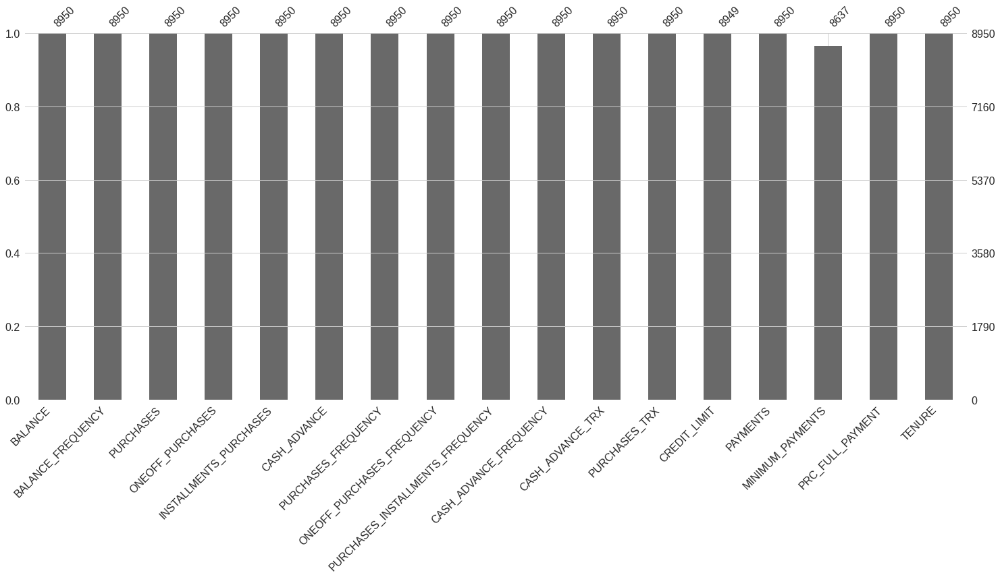

In [ ]:
msno.bar(data)

<Axes: >

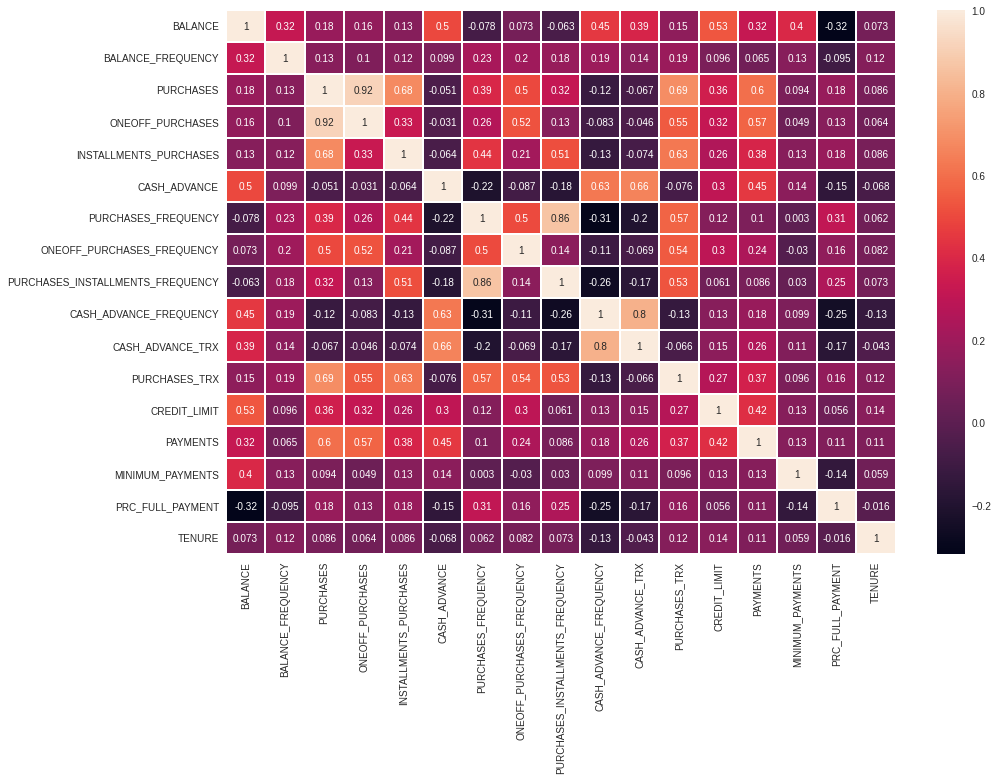

In [ ]:
plt.figure(figsize = (15,10))
sns.heatmap(data.corr(), linecolor='white', linewidths=2,annot=True)

In [ ]:
data.corr()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
BALANCE,1.000000,0.322412,0.181261,0.164350,0.126469,0.496692,-0.077944,0.073166,-0.063186,0.449218,0.385152,0.154338,0.531283,0.322802,0.398684,-0.318959,0.072692
BALANCE_FREQUENCY,0.322412,1.000000,0.133674,0.104323,0.124292,0.099388,0.229715,0.202415,0.176079,0.191873,0.141555,0.189626,0.095843,0.065008,0.132569,-0.095082,0.119776
PURCHASES,0.181261,0.133674,1.000000,0.916845,0.679896,-0.051474,0.393017,0.498430,0.315567,-0.120143,-0.067175,0.689561,0.356963,0.603264,0.093860,0.180379,0.086288
ONEOFF_PURCHASES,0.164350,0.104323,0.916845,1.000000,0.330622,-0.031326,0.264937,0.524891,0.127729,-0.082628,-0.046212,0.545523,0.319724,0.567292,0.048755,0.132763,0.064150
INSTALLMENTS_PURCHASES,0.126469,0.124292,0.679896,0.330622,1.000000,-0.064244,0.442418,0.214042,0.511351,-0.132318,-0.073999,0.628108,0.256499,0.384084,0.132172,0.182569,0.086143
CASH_ADVANCE,0.496692,0.099388,-0.051474,-0.031326,-0.064244,1.000000,-0.215507,-0.086754,-0.177070,0.628522,0.656498,-0.075850,0.303985,0.453238,0.140107,-0.152935,-0.068312
PURCHASES_FREQUENCY,-0.077944,0.229715,0.393017,0.264937,0.442418,-0.215507,1.000000,0.501343,0.862934,-0.308478,-0.203478,0.568430,0.119788,0.103464,0.003030,0.305802,0.061506
ONEOFF_PURCHASES_FREQUENCY,0.073166,0.202415,0.498430,0.524891,0.214042,-0.086754,0.501343,1.000000,0.142329,-0.111716,-0.069088,0.544869,0.295038,0.243537,-0.030327,0.157531,0.082466
PURCHASES_INSTALLMENTS_FREQUENCY,-0.063186,0.176079,0.315567,0.127729,0.511351,-0.177070,0.862934,0.142329,1.000000,-0.262958,-0.169207,0.529975,0.060755,0.085551,0.030073,0.250087,0.073275
CASH_ADVANCE_FREQUENCY,0.449218,0.191873,-0.120143,-0.082628,-0.132318,0.628522,-0.308478,-0.111716,-0.262958,1.000000,0.799561,-0.131168,0.132616,0.183192,0.098838,-0.249773,-0.133372


array([[<Axes: title={'center': 'BALANCE'}>,
        <Axes: title={'center': 'BALANCE_FREQUENCY'}>,
        <Axes: title={'center': 'PURCHASES'}>,
        <Axes: title={'center': 'ONEOFF_PURCHASES'}>],
       [<Axes: title={'center': 'INSTALLMENTS_PURCHASES'}>,
        <Axes: title={'center': 'CASH_ADVANCE'}>,
        <Axes: title={'center': 'PURCHASES_FREQUENCY'}>,
        <Axes: title={'center': 'ONEOFF_PURCHASES_FREQUENCY'}>],
       [<Axes: title={'center': 'PURCHASES_INSTALLMENTS_FREQUENCY'}>,
        <Axes: title={'center': 'CASH_ADVANCE_FREQUENCY'}>,
        <Axes: title={'center': 'CASH_ADVANCE_TRX'}>,
        <Axes: title={'center': 'PURCHASES_TRX'}>],
       [<Axes: title={'center': 'CREDIT_LIMIT'}>,
        <Axes: title={'center': 'PAYMENTS'}>,
        <Axes: title={'center': 'MINIMUM_PAYMENTS'}>,
        <Axes: title={'center': 'PRC_FULL_PAYMENT'}>],
       [<Axes: title={'center': 'TENURE'}>, <Axes: >, <Axes: >, <Axes: >]],
      dtype=object)

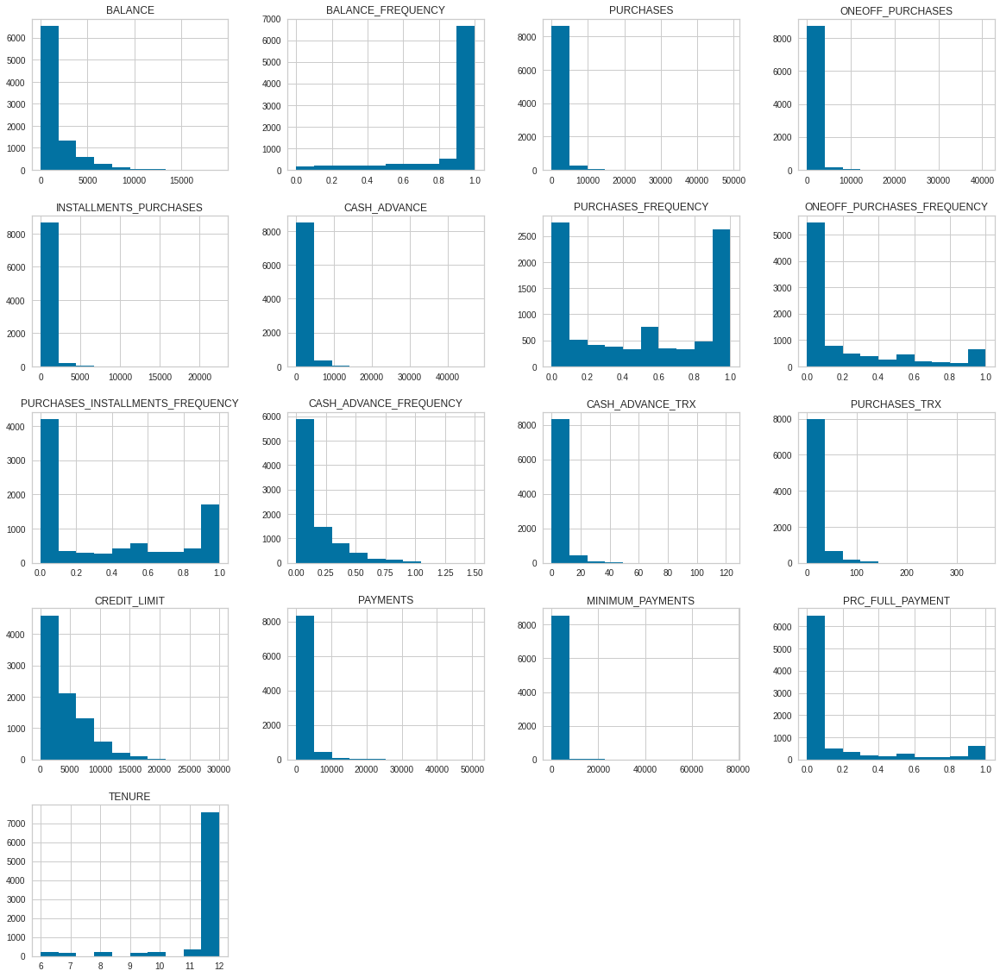

In [ ]:
data.hist(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE'],figsize=(20,20))

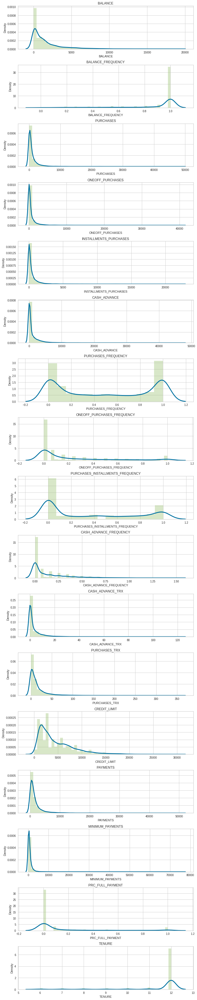

In [ ]:
plt.figure(figsize=(10,50))
for i in range(len(data.columns)):
  plt.subplot(17,1,i+1)
  sns.distplot(data[data.columns[i]],kde_kws={'color':'b','lw':3,'label':'KDE'},hist_kws={'color':'g'})
  plt.title(data.columns[i])
plt.tight_layout()

**Most of the features are heavily skewed might as well look for outliers**

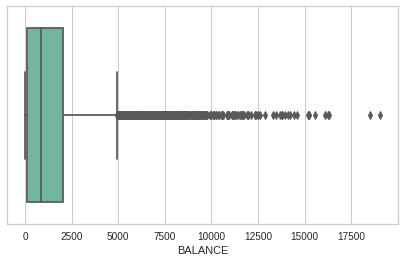

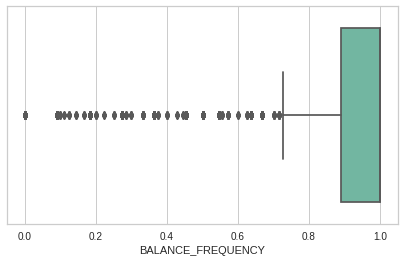

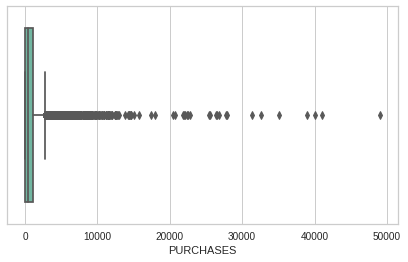

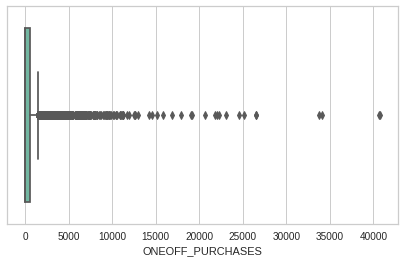

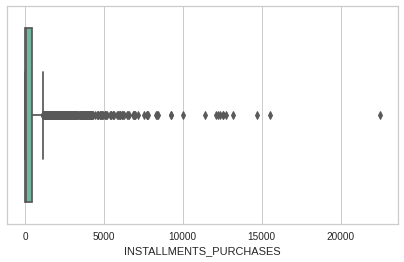

...

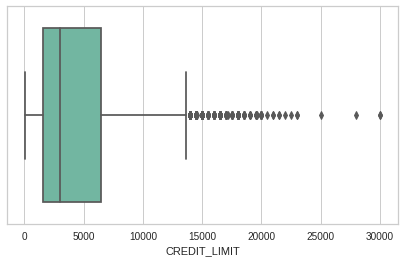

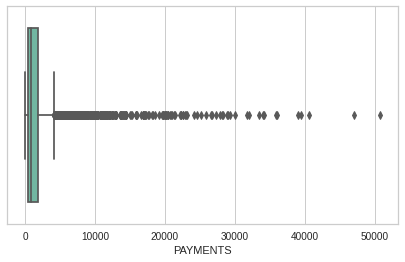

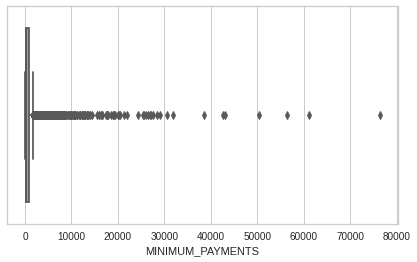

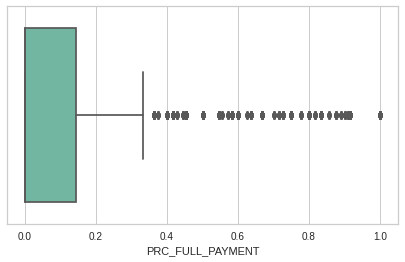

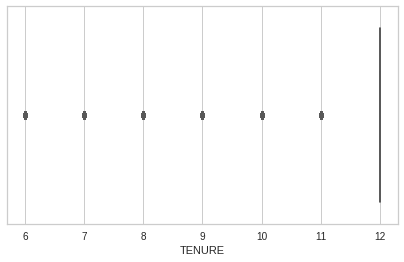

In [ ]:
num_cols = data.keys()
for i in num_cols:
    if data[i].dtypes !="object":
      plt.figure(figsize=(7,4))
      sns.boxplot(x=data[i],palette="Set2");
      plt.show()

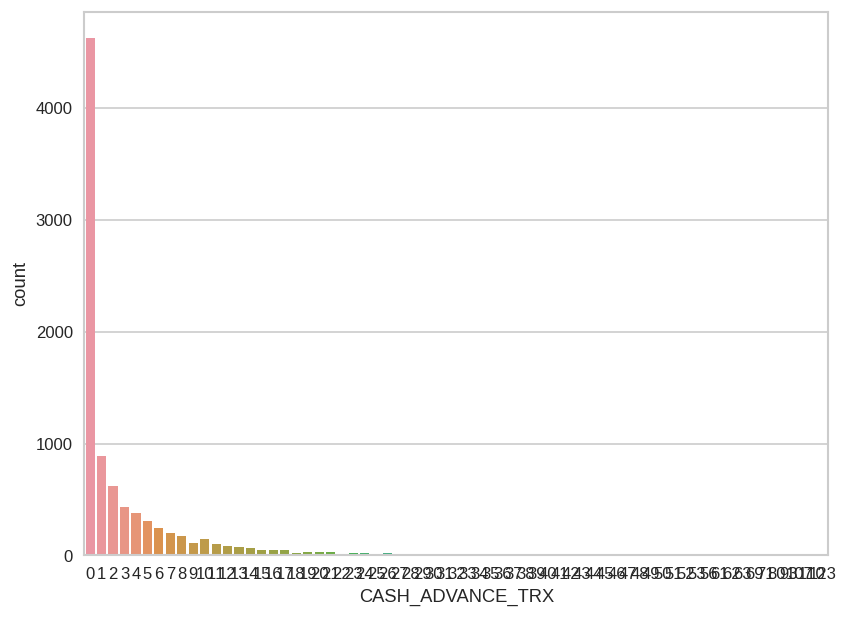

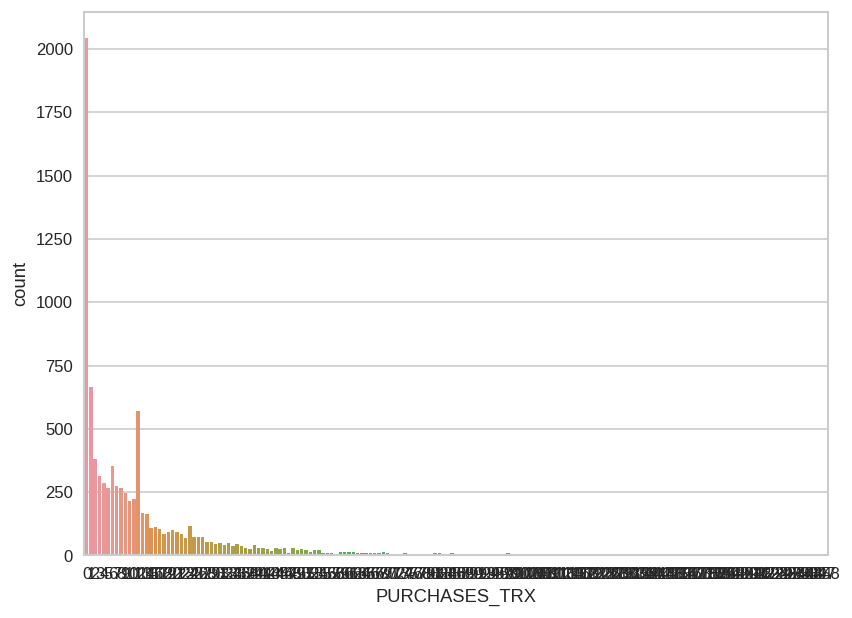

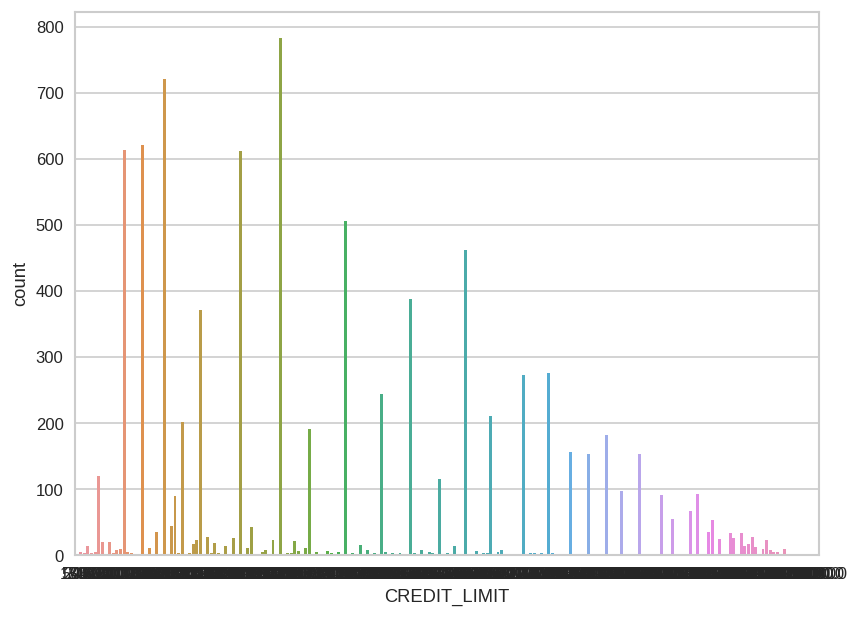

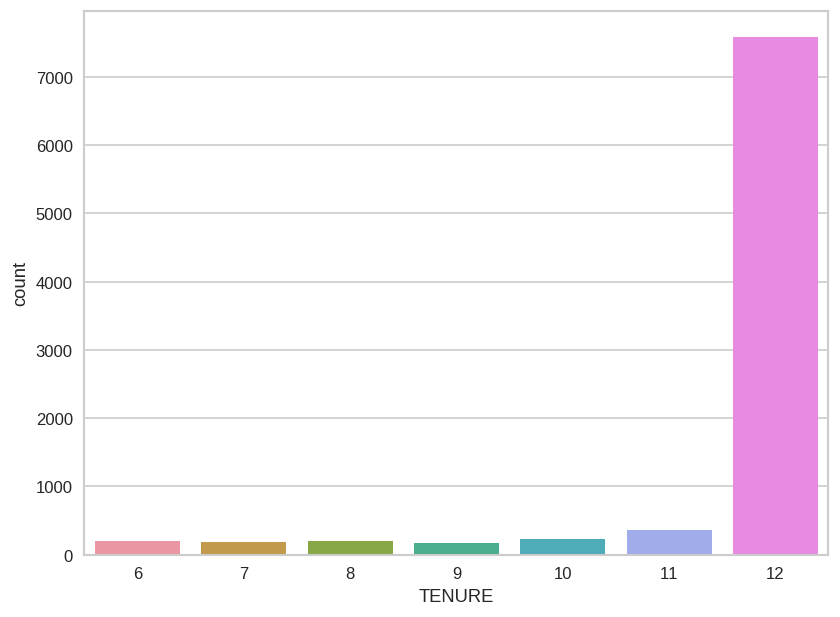

In [ ]:
#Ploting discrete feature
dis= ['CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'TENURE']
for i in range(4):
  fig = plt.figure(figsize = (8, 6), dpi = 120)
  sns.countplot(x=dis[i],data=data)
  plt.show()

**Conclusion**


*   Due to the fact that there is a big difference between the mean and median that means that the data is in fact skewed 

*   MINIMUM_PAYMENTS has missing values with a percentage of 3% and has no corelation with any featcure which mostly means the data is missing randomly and since the data is skewed using the median to empute the data is a great choice or i could remove the whole column

*  Tenure,PRC_FULL_PAYMENT,BALANCE_FREQUENCY and MINIMUM_PAYMENTS have no correlation with the other features so i could maybe drop them

*  When features are highly correlated, it means that they are providing similar information to the model, which can lead to redundancy and make it more difficult for the model to distinguish between different patterns in the data

*   PURCHASES has a correlation with ONEOFF_PURCHASES_FREQUENCY,PAYMENTS,PURCHASES_TRX and INSTALLMENTS_PURCHASES

*   ONEOFF_PURCHASES has correlation with PURCHASES,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_TRX and PAYMENTS

*   INSTALLMENTS_PURCHASES has a correlation with PURCHASES,PURCHASES_INSTALLMENT_FREQUENCY and PURCHASES_TRX

*  CASH_ADVANCE has a correlation with CASH_ADVANCE_FREQUENCY,BALANCE and CASH_ADVANCE_TRX

*   There are no duplicates in the data

*   Now it depends on our application whether we want to handle the skewness in our dataset or not for a clustering problem. For instance if we want to do clustering for anamoly detection in that case we wouldn't want to handle the outliers as we would like our model to detect them and group them in a cluster. For our application I am looking for a good visualization so I would like to handle the skewness as much as possible as it will help the model to form better clusters.













###**Preprocessing**

**There are nulls in both MINIMUM_PAYMENTS and CREDIT_LIMIT and they both have little to no correlation with the other features so they might be randomly missing and there is not point in using knnimputer so ill fill them with median since there are outliers or i could drop them since there arent that many**

In [ ]:
#Handeling nulls
data['MINIMUM_PAYMENTS'].fillna(data['MINIMUM_PAYMENTS'].median(),inplace=True)
data['CREDIT_LIMIT'].fillna(data['CREDIT_LIMIT'].median(),inplace=True)

In [ ]:
data.isna().sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

In [ ]:
df=data

In [ ]:
#Handelling outliers by setting them first as null
for col in data.columns:

    d = data[col]
    
    Q1 = d.quantile(0.25)
    Q3 = d.quantile(0.75)

    IQR = Q3 - Q1

    min = Q1 - (1.5 * IQR)
    max = Q3 + (1.5 * IQR)
 
    outliers = ( (d< min) | (d> max) )

    data.loc[outliers, col] = np.nan
    
data.isna().sum()

BALANCE                              695
BALANCE_FREQUENCY                   1493
PURCHASES                            808
ONEOFF_PURCHASES                    1013
INSTALLMENTS_PURCHASES               867
CASH_ADVANCE                        1030
PURCHASES_FREQUENCY                    0
ONEOFF_PURCHASES_FREQUENCY           782
PURCHASES_INSTALLMENTS_FREQUENCY       0
CASH_ADVANCE_FREQUENCY               525
CASH_ADVANCE_TRX                     804
PURCHASES_TRX                        766
CREDIT_LIMIT                         248
PAYMENTS                             808
MINIMUM_PAYMENTS                     909
PRC_FULL_PAYMENT                    1474
TENURE                              1366
dtype: int64

In [ ]:
#Each samples missing values are imputed using the mean value from n_neighbors nearest neighbors found in the training set
imputer = KNNImputer()

data= pd.DataFrame(imputer.fit_transform(data), columns=data.columns)

data.isna().sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.0,1233.151185,1270.061120,0.000000,128.281915,868.532619,1946.311892,4940.113918
BALANCE_FREQUENCY,8950.0,0.977871,0.060313,0.727273,1.000000,1.000000,1.000000,1.000000
PURCHASES,8950.0,613.657575,673.407056,0.000000,39.550000,360.000000,1026.822500,2711.900000
ONEOFF_PURCHASES,8950.0,230.756709,345.302791,0.000000,0.000000,26.750000,356.760000,1443.330000
INSTALLMENTS_PURCHASES,8950.0,224.571710,285.181789,0.000000,0.000000,89.000000,375.839500,1170.490000
CASH_ADVANCE,8950.0,453.915766,700.380212,0.000000,0.000000,0.000000,831.566156,2784.294727
PURCHASES_FREQUENCY,8950.0,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.000000
ONEOFF_PURCHASES_FREQUENCY,8950.0,0.169167,0.227151,0.000000,0.000000,0.083333,0.271212,0.750000
PURCHASES_INSTALLMENTS_FREQUENCY,8950.0,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.000000
CASH_ADVANCE_FREQUENCY,8950.0,0.105089,0.140755,0.000000,0.000000,0.000000,0.166667,0.545455


In [ ]:
#Handeling skeweness
cols = ['BALANCE', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'ONEOFF_PURCHASES_FREQUENCY','PURCHASES_INSTALLMENTS_FREQUENCY', 
        'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT']
for col in cols:
    data[col] = np.log(1 + data[col])

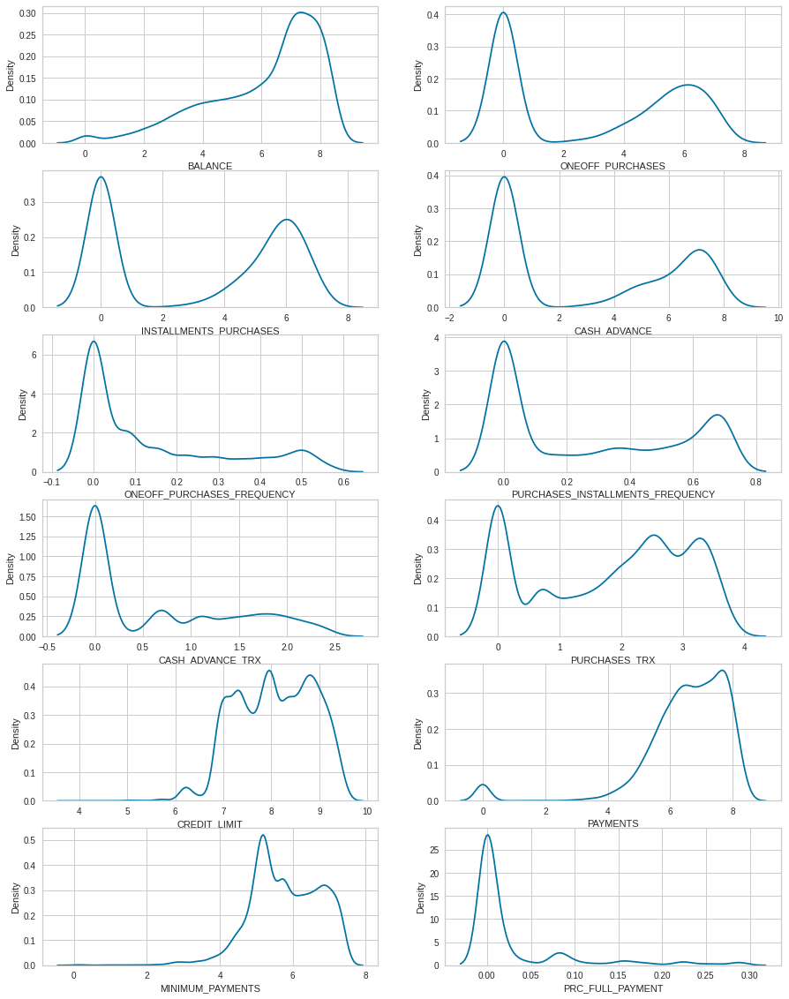

In [ ]:
plt.figure(figsize=(15,20))
for i, col in enumerate(cols):
    ax = plt.subplot(6, 2, i+1)
    sns.kdeplot(data[col], ax=ax)
plt.show()

In [ ]:
#Standarization
scaler=StandardScaler()
scaled_data=scaler.fit_transform(data)

In [ ]:
df_scaled = pd.DataFrame(scaled_data, columns=data.columns)
df_scaled

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-1.217761,-2.647827,-0.769648,-0.996095,0.472151,-0.915419,-0.806490,-0.783153,-0.674253,-0.746650,-0.823188,-0.572218,-1.475389,-0.824434,-0.876758,-0.461584,0.0
1,1.026314,-1.140453,-0.911324,-0.996095,-1.103622,1.202663,-1.221758,-0.783153,-0.958256,1.029590,1.186160,-1.450861,0.980374,1.222404,1.228893,2.739668,0.0
2,0.897215,0.366920,0.236887,1.271062,-1.103622,-0.915419,1.269843,2.028474,-0.958256,-0.746650,-0.823188,0.600522,1.067470,-0.060536,0.674287,-0.461584,0.0
3,0.688511,0.065446,1.314794,0.960132,-1.103622,0.703738,-1.014125,-0.333751,-0.958256,-0.154572,0.042191,-0.896499,1.067470,-4.439828,-0.046176,-0.461584,0.0
4,0.320363,0.366920,-0.887563,-0.030439,-1.103622,-0.915419,-1.014125,-0.333751,-0.958256,-0.746650,-0.823188,-0.896499,-1.245406,-0.001693,-0.297641,-0.461584,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,-1.399460,0.366920,-0.478991,-0.996095,0.854551,-0.915419,1.269843,-0.783153,1.192408,-0.746650,-0.823188,0.105430,-1.475389,-0.500146,-1.949159,-0.197897,0.0
8946,-1.595743,0.366920,-0.465803,-0.996095,0.864880,-0.915419,1.269843,-0.783153,1.192408,-0.746650,-0.823188,0.105430,-1.475389,-0.612579,-0.046176,-0.461584,0.0
8947,-1.497592,-2.396606,-0.696880,-0.996095,0.613908,-0.915419,0.854576,-0.783153,0.854234,-0.746650,-0.823188,-0.017856,-1.475389,-1.438463,-1.416732,3.098176,0.0
8948,-1.768386,-2.396606,-0.911324,-0.996095,-1.103622,0.185715,-1.221758,-0.783153,-0.958256,0.437513,0.548405,-1.450861,-2.349274,-1.730704,-1.815559,3.098176,0.0


PCA
it is recommended to perform PCA before clustering. The main reason for this is that PCA can help reduce the dimensionality of the data 
and identify the most important patterns or trends in the data. 
This can make clustering more effective by reducing the noise 
and improving the separation between clusters.

In [ ]:
pca =PCA()
X_pca = pca.fit_transform(df_scaled)

In [ ]:
component_names = [f"PC{i+1}" for i in range(X_pca.shape[1])]

X_pca = pd.DataFrame(X_pca, columns=component_names)

X_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17
0,-0.414115,3.225682,-0.042652,0.680459,-0.312299,2.433264,0.601053,0.188645,0.161877,-0.095203,0.294554,0.119737,-0.778490,0.201696,0.009021,0.137400,0.0
1,-3.333467,-1.205820,0.478833,2.501608,-2.133631,-0.625816,0.563848,-1.224518,-0.107411,0.150502,0.066735,0.138497,0.034389,-0.134353,-0.129693,0.010523,-0.0
2,1.420857,-1.348206,-2.598427,-0.940103,-0.200212,-0.057881,0.045875,-0.679252,-1.019139,1.010193,-0.006339,-0.258890,0.465682,0.239118,-0.047526,0.581270,0.0
3,-1.389450,0.477975,-1.834200,-1.213305,1.575038,0.677834,-1.858189,-2.900416,2.352453,-0.072255,-0.762442,-0.710246,0.555168,-0.067620,0.212831,0.110977,0.0
4,-1.156836,1.557037,-1.336126,-0.943781,-0.353064,-0.136987,1.392181,0.455495,-0.140071,-0.138681,-0.049734,-0.488453,0.075455,-0.037094,-0.101299,-0.081570,-0.0


In [ ]:
pca.explained_variance_ratio_

array([0.3403498 , 0.20059172, 0.10300275, 0.07866035, 0.06064319,
       0.05624656, 0.04646061, 0.03699915, 0.01921237, 0.01439886,
       0.01228751, 0.01090871, 0.00866529, 0.00512349, 0.00442356,
       0.00202609, 0.        ])

In [ ]:
pca.explained_variance_ratio_.cumsum()


array([0.3403498 , 0.54094152, 0.64394427, 0.72260462, 0.78324781,
       0.83949437, 0.88595498, 0.92295412, 0.9421665 , 0.95656536,
       0.96885287, 0.97976158, 0.98842687, 0.99355035, 0.99797391,
       1.        , 1.        ])

In [ ]:
# Get feature importance
abs_feature_values = np.abs(pca.components_).sum(axis=0)
feature_importance = pd.DataFrame([abs_feature_values], columns=df.columns, index=["feature_importance"]).T

print("-> Feature importance scores", end="\n\n")
feature_importance['feature_importance'].sort_values(ascending=False)

-> Feature importance scores



ONEOFF_PURCHASES_FREQUENCY          3.081520
CASH_ADVANCE_FREQUENCY              3.041999
MINIMUM_PAYMENTS                    2.992987
CASH_ADVANCE                        2.984231
BALANCE                             2.781448
PURCHASES_INSTALLMENTS_FREQUENCY    2.769925
ONEOFF_PURCHASES                    2.737975
CASH_ADVANCE_TRX                    2.707442
PURCHASES_FREQUENCY                 2.670592
PAYMENTS                            2.661995
PURCHASES_TRX                       2.613418
INSTALLMENTS_PURCHASES              2.497706
PURCHASES                           2.364112
PRC_FULL_PAYMENT                    2.317458
CREDIT_LIMIT                        2.203215
BALANCE_FREQUENCY                   1.863025
TENURE                              1.000000
Name: feature_importance, dtype: float64

In [ ]:
def plot_variance(pca, width=8, dpi=100):
  
    # Create figure
    fig, axs = plt.subplots(1, 2)
    n = pca.n_components_
    grid = np.arange(1, n + 1)

    # Explained variance
    evr = pca.explained_variance_ratio_
    axs[0].bar(grid, evr)
    axs[0].set(
        xlabel="Component", title="% Explained Variance", ylim=(0.0, 1.0)
    )

    # Cumulative Variance
    cv = np.cumsum(evr)
    axs[1].plot(np.r_[0, grid], np.r_[0, cv], "o-")
    axs[1].set(
        xlabel="Component", title="% Cumulative Variance", ylim=(0.0, 1.0)
    )
    # Set up figure

    fig.set(figwidth=8, dpi=100)
    return axs

array([<Axes: title={'center': '% Explained Variance'}, xlabel='Component'>,
       <Axes: title={'center': '% Cumulative Variance'}, xlabel='Component'>],
      dtype=object)

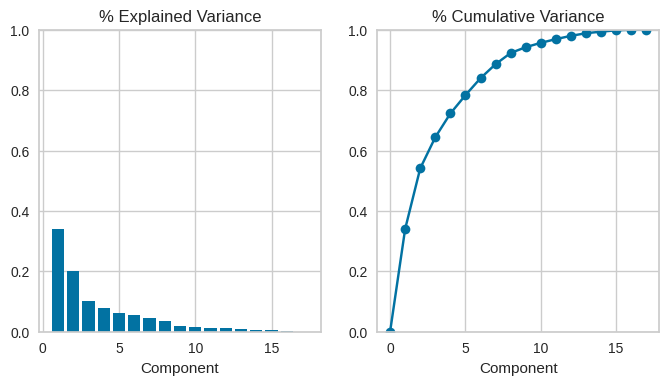

In [ ]:
plot_variance(pca)

About 80% of the Variance in the data is explained by only 5 components.
And About 90% of the variance in the data is explained by only 7 components.

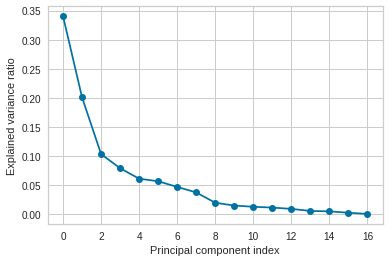

In [ ]:
#Finding the optimal number of components
plt.plot(pca.explained_variance_ratio_, '-o')

plt.xlabel('Principal component index')
plt.ylabel('Explained variance ratio')
plt.show()

In [ ]:
pca = PCA(n_components =5)

X_pca = pca.fit_transform(df_scaled)

In [ ]:
component_names = [f"PC{i+1}" for i in range(X_pca.shape[1])]

X_pca = pd.DataFrame(X_pca, columns=component_names)

X_pca.head()

,PC1,PC2,PC3,PC4,PC5
0,-0.414115,3.225682,-0.042652,0.680459,-0.312299
1,-3.333467,-1.205820,0.478833,2.501608,-2.133631
2,1.420857,-1.348206,-2.598428,-0.940103,-0.200212
3,-1.389450,0.477975,-1.834200,-1.213305,1.575038
4,-1.156836,1.557037,-1.336126,-0.943782,-0.353064


In [ ]:
pca.explained_variance_ratio_

array([0.3403498 , 0.20059172, 0.10300275, 0.07866035, 0.06064319])

In [ ]:
pca.explained_variance_ratio_.cumsum()

array([0.3403498 , 0.54094152, 0.64394427, 0.72260462, 0.78324781])

array([<Axes: title={'center': '% Explained Variance'}, xlabel='Component'>,
       <Axes: title={'center': '% Cumulative Variance'}, xlabel='Component'>],
      dtype=object)

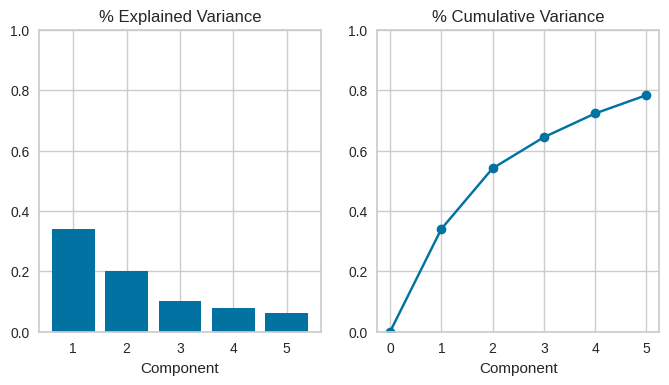

In [ ]:
plot_variance(pca)

In [ ]:
dat=X_pca
dat

,PC1,PC2,PC3,PC4,PC5
0,-0.414115,3.225682,-0.042652,0.680459,-0.312299
1,-3.333467,-1.205820,0.478833,2.501608,-2.133631
2,1.420857,-1.348206,-2.598428,-0.940103,-0.200212
3,-1.389450,0.477975,-1.834200,-1.213305,1.575038
4,-1.156836,1.557037,-1.336126,-0.943782,-0.353064
...,...,...,...,...,...
8945,1.627819,2.954453,1.513285,-0.236472,0.767218
8946,1.429555,2.320610,1.668528,-1.025965,0.504431
8947,1.261124,3.644099,1.365283,2.914489,0.020591
8948,-2.385024,3.801395,0.049053,3.767355,1.163199


###**Modelling**

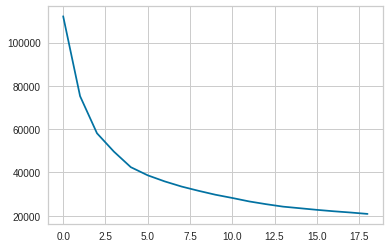

In [ ]:
#kmeans after pca
scores=[]
for i in range(1,20):
  kmeans=KMeans(n_clusters=i)
  kmeans.fit(dat)
  scores.append(kmeans.inertia_)
plt.plot(scores)

In [ ]:
kmeans=KMeans(3)
kmeans.fit(dat)
labels=kmeans.labels_

In [ ]:
kmeans.cluster_centers_.shape

(3, 5)

In [ ]:
dat=pd.concat([dat,pd.DataFrame({'Clusters':labels})],axis=1)
dat

,PC1,PC2,PC3,PC4,PC5,Clusters
0,-0.414115,3.225682,-0.042652,0.680459,-0.312299,2
1,-3.333467,-1.205820,0.478833,2.501608,-2.133631,1
2,1.420857,-1.348206,-2.598428,-0.940103,-0.200212,0
3,-1.389450,0.477975,-1.834200,-1.213305,1.575038,1
4,-1.156836,1.557037,-1.336126,-0.943782,-0.353064,2
...,...,...,...,...,...,...
8945,1.627819,2.954453,1.513285,-0.236472,0.767218,2
8946,1.429555,2.320610,1.668528,-1.025965,0.504431,2
8947,1.261124,3.644099,1.365283,2.914489,0.020591,2
8948,-2.385024,3.801395,0.049053,3.767355,1.163199,2


In [ ]:
da=pd.concat([data,pd.DataFrame({'Clusters':labels})],axis=1)

In [ ]:
da

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Clusters
0,3.735304,0.818182,95.40,0.000000,4.568506,0.000000,0.166667,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,12.0,2
1,8.071989,0.909091,0.00,0.000000,0.000000,6.974598,0.000000,0.000000,0.000000,0.250000,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,12.0,1
2,7.822504,1.000000,773.17,6.651791,0.000000,0.000000,1.000000,0.500775,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,12.0,0
3,7.419183,0.981818,1499.00,5.739529,0.000000,5.331694,0.083333,0.080042,0.000000,0.083333,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,12.0,1
4,6.707735,1.000000,16.00,2.833213,0.000000,0.000000,0.083333,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,12.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,3.384170,1.000000,291.12,0.000000,5.677165,0.000000,1.000000,0.000000,0.606136,0.000000,0.000000,1.945910,6.908755,5.788719,3.909748,0.016529,12.0,2
8946,3.004851,1.000000,300.00,0.000000,5.707110,0.000000,1.000000,0.000000,0.606136,0.000000,0.000000,1.945910,6.908755,5.623517,5.747301,0.000000,12.0,2
8947,3.194529,0.833333,144.40,0.000000,4.979489,0.000000,0.833333,0.000000,0.510826,0.000000,0.000000,1.791759,6.908755,4.410016,4.423869,0.223144,12.0,2
8948,2.671218,0.833333,0.00,0.000000,0.000000,3.625907,0.000000,0.000000,0.000000,0.166667,1.098612,0.000000,6.216606,3.980615,4.038755,0.223144,12.0,2


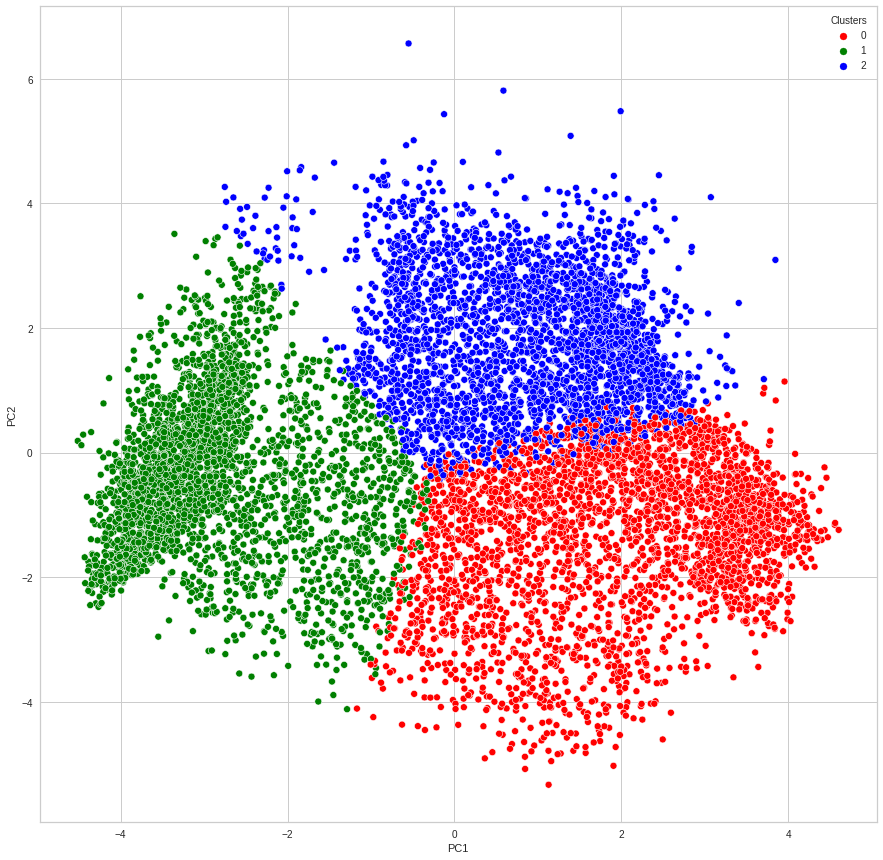

In [ ]:
plt.figure(figsize=(15,15))
ax=sns.scatterplot(x='PC1',y='PC2',hue='Clusters',data=dat,palette=['red','green','blue','pink','yellow'])
plt.show()

In [ ]:
fig = px.scatter_3d( X_pca, x= X_pca["PC1"], y= X_pca["PC2"], z = X_pca["PC3"] , color =labels)
fig.show()

In [ ]:
da

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Clusters
0,3.735304,0.818182,95.40,0.000000,4.568506,0.000000,0.166667,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,12.0,2
1,8.071989,0.909091,0.00,0.000000,0.000000,6.974598,0.000000,0.000000,0.000000,0.250000,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,12.0,1
2,7.822504,1.000000,773.17,6.651791,0.000000,0.000000,1.000000,0.500775,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,12.0,0
3,7.419183,0.981818,1499.00,5.739529,0.000000,5.331694,0.083333,0.080042,0.000000,0.083333,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,12.0,1
4,6.707735,1.000000,16.00,2.833213,0.000000,0.000000,0.083333,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,12.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,3.384170,1.000000,291.12,0.000000,5.677165,0.000000,1.000000,0.000000,0.606136,0.000000,0.000000,1.945910,6.908755,5.788719,3.909748,0.016529,12.0,2
8946,3.004851,1.000000,300.00,0.000000,5.707110,0.000000,1.000000,0.000000,0.606136,0.000000,0.000000,1.945910,6.908755,5.623517,5.747301,0.000000,12.0,2
8947,3.194529,0.833333,144.40,0.000000,4.979489,0.000000,0.833333,0.000000,0.510826,0.000000,0.000000,1.791759,6.908755,4.410016,4.423869,0.223144,12.0,2
8948,2.671218,0.833333,0.00,0.000000,0.000000,3.625907,0.000000,0.000000,0.000000,0.166667,1.098612,0.000000,6.216606,3.980615,4.038755,0.223144,12.0,2


**Cluster Analysis**

<Figure size 1440x2520 with 0 Axes>

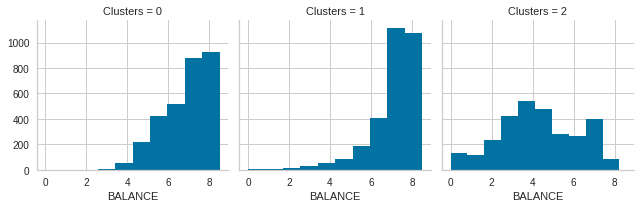

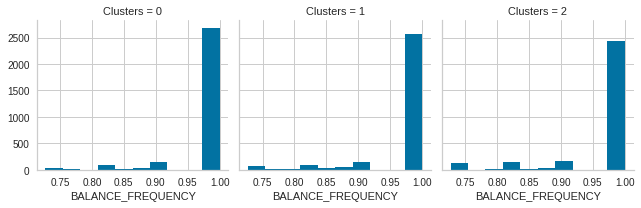

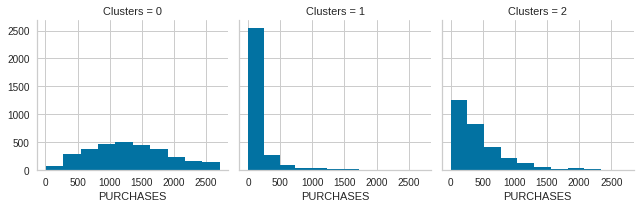

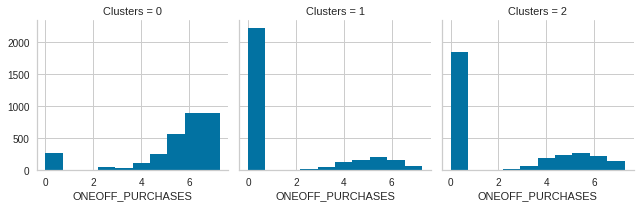

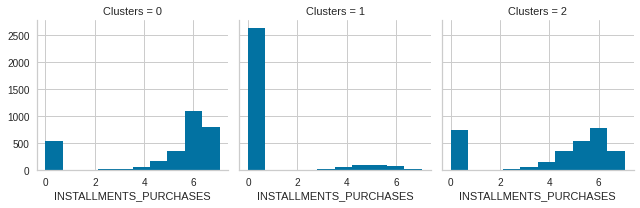

...

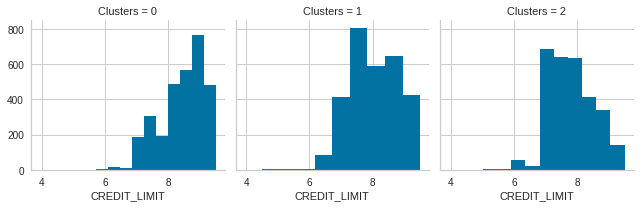

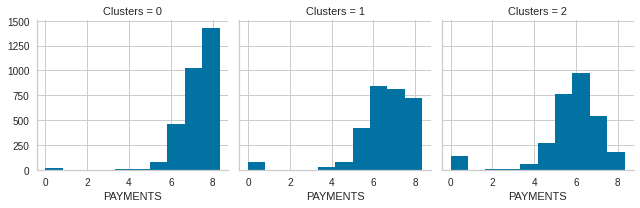

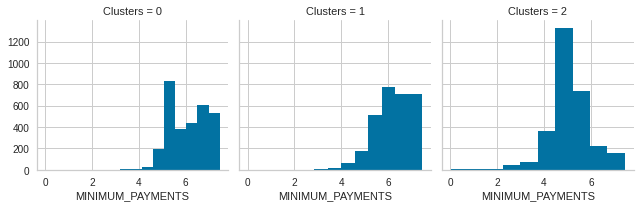

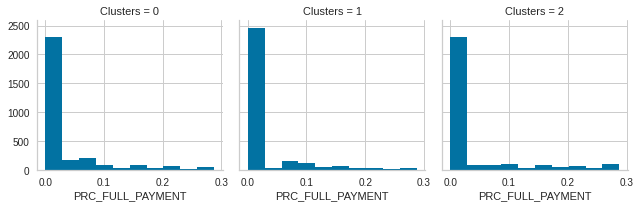

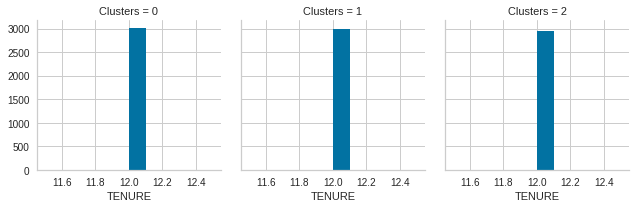

In [ ]:
plt.figure(figsize=(20,35))

for col in df.columns:

    grid = sns.FacetGrid(da, col='Clusters')

    grid.map(plt.hist, col)
    
    plt.show()


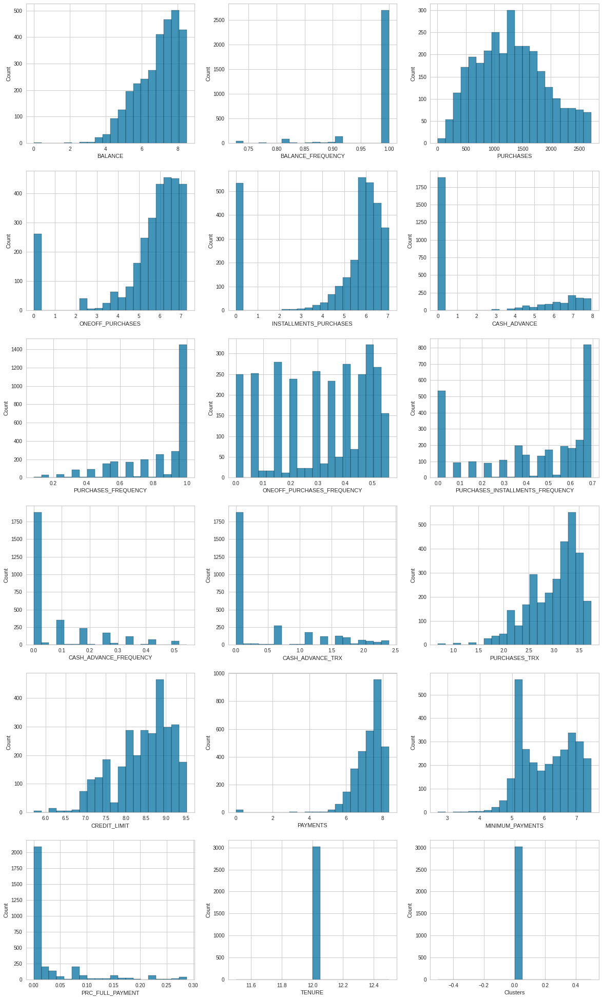

In [ ]:
plt.figure(figsize=(20,35))

for i, col in enumerate(da.columns):

        ax = plt.subplot(6, 3, i+1)

        sns.histplot( x = col , ax=ax , bins=20 , data = da[da['Clusters'] == 0])

        plt.xlabel(col)
        
plt.show()

**Cluster 0**
Customers with heigh balance tend to have low purchases and tend to update their balance frequently and may pay in advance

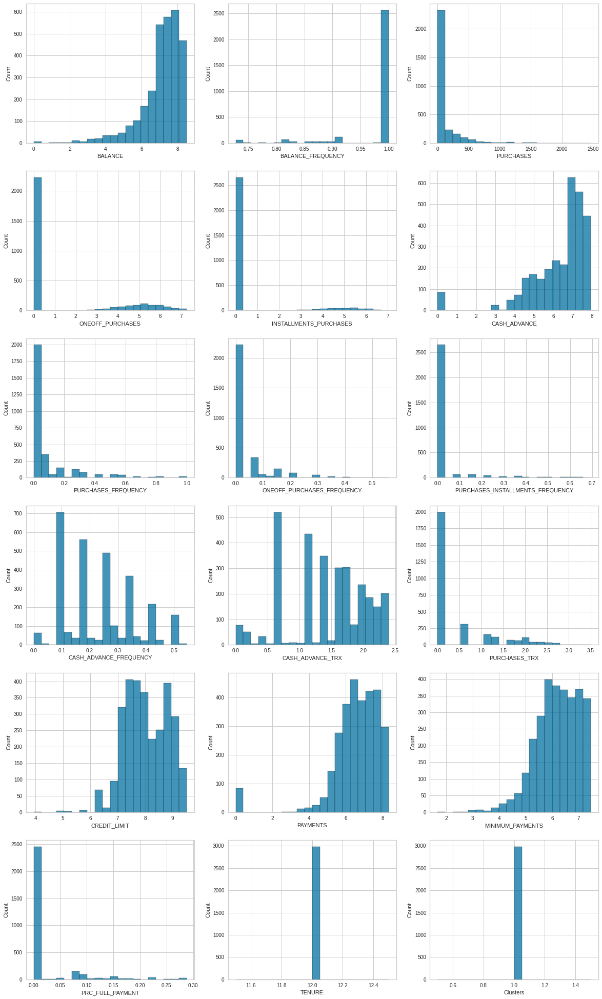

In [ ]:
plt.figure(figsize=(20,35))

for i, col in enumerate(da.columns):

        ax = plt.subplot(6, 3, i+1)

        sns.histplot( x = col , ax=ax , bins=20 , data = da[da['Clusters'] == 1])

        plt.xlabel(col)
        
plt.show()

**Cluster 1**
customers with Medium Balance do purchase installments more often than those who dont they also tend to have medium purchase transactions and payments

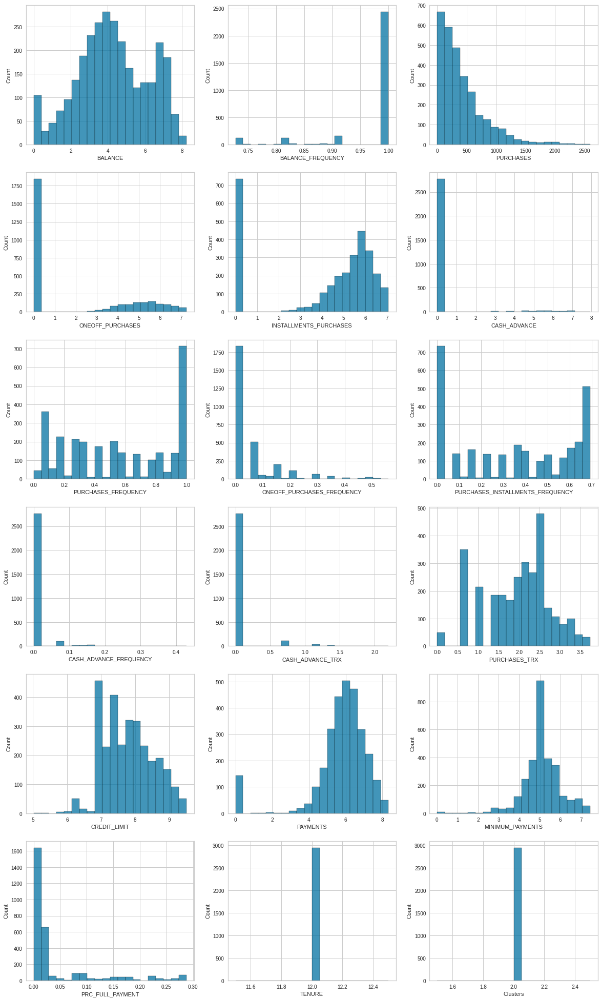

In [ ]:
plt.figure(figsize=(20,35))

for i, col in enumerate(da.columns):

        ax = plt.subplot(6, 3, i+1)

        sns.histplot( x = col , ax=ax , bins=20 , data = da[da['Clusters'] == 2])

        plt.xlabel(col)
        
plt.show()

**Cluster 2**
Customers with heigh balance tend to update their balance alot and they tend to be making alot of on-off purchases and purchase transactions 

##BIRCH algorithm

BIRCH (balanced iterative reducing and clustering using hierarchies) is an unsupervised data mining algorithm used to perform hierarchical clustering over particularly large data-sets.


In [ ]:
clusters=pd.concat([da, pd.DataFrame({'cluster':labels})], axis=1)
clusters.drop(['cluster','Clusters'],axis=1,inplace=True)
clusters.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,3.735304,0.818182,95.40,0.000000,4.568506,0.000000,0.166667,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,12.0
1,8.071989,0.909091,0.00,0.000000,0.000000,6.974598,0.000000,0.000000,0.000000,0.250000,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,12.0
2,7.822504,1.000000,773.17,6.651791,0.000000,0.000000,1.000000,0.500775,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,12.0
3,7.419183,0.981818,1499.00,5.739529,0.000000,5.331694,0.083333,0.080042,0.000000,0.083333,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,12.0
4,6.707735,1.000000,16.00,2.833213,0.000000,0.000000,0.083333,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,12.0


In [ ]:
da.drop(['Clusters'],axis=1,inplace=True)

In [ ]:
birch_model = Birch(threshold=0.20, n_clusters=3)
birch_model.fit(X_pca)
birch_result = birch_model.predict(X_pca)

In [ ]:
clusters=pd.concat([da, pd.DataFrame({'cluster_birch':birch_result})], axis=1)
clusters.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster_birch
0,3.735304,0.818182,95.40,0.000000,4.568506,0.000000,0.166667,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,12.0,0
1,8.071989,0.909091,0.00,0.000000,0.000000,6.974598,0.000000,0.000000,0.000000,0.250000,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,12.0,1
2,7.822504,1.000000,773.17,6.651791,0.000000,0.000000,1.000000,0.500775,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,12.0,0
3,7.419183,0.981818,1499.00,5.739529,0.000000,5.331694,0.083333,0.080042,0.000000,0.083333,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,12.0,1
4,6.707735,1.000000,16.00,2.833213,0.000000,0.000000,0.083333,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,12.0,0


In [ ]:
silhouette_score(clusters[da.columns],clusters['cluster_birch'])*100

4.704563792251709

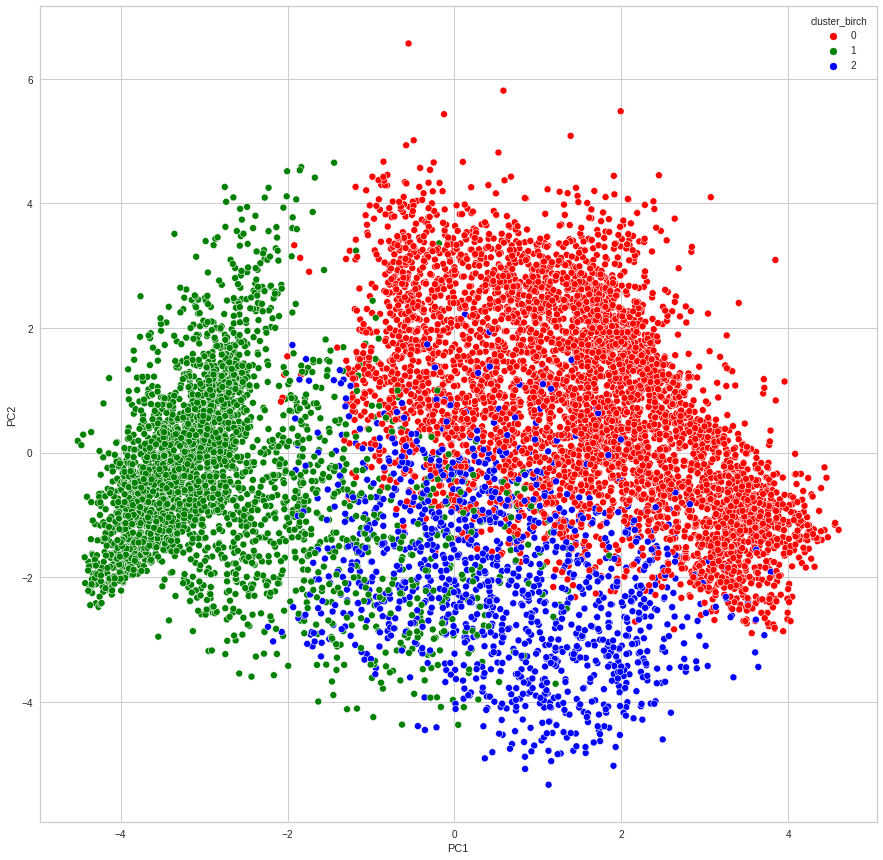

In [ ]:
plt.figure(figsize=(15,15))
ax=sns.scatterplot(x=X_pca["PC1"],y=X_pca["PC2"],hue='cluster_birch',data=clusters,palette=['red','green','blue','pink','gray','yellow','black'])
plt.show()

In [ ]:
fig=px.scatter_3d(X_pca,x=X_pca["PC1"],y=X_pca["PC2"],z=X_pca["PC3"],color=clusters.cluster_birch,labels={'color':'cluster_birch'})
fig.update_traces(marker_size=5)
fig.show()